# Natural Gradient Variational Inference with Mixture of Gaussian posterior

In this notebook, NGVI with `GMM` posterior is implemented in pytorch. <br/>
The forms of prior, likelihood and approximate posterior are assumed and predefined. 

In [1]:
import math
import torch
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation, rc

In [2]:
softplus = torch.nn.Softplus()
softmax = torch.nn.Softmax(dim=0)
num_samples = 1  # Number of samples
num_components = 2
num_steps = 3000
beta = .1

## Sampling
`gaussian_sample` function samples from a gaussian with reparameterization.<br />


In [3]:
def gaussian_sample(mean, std, num_samples, D=1):
    eps = torch.randn(size=(num_samples, D))
    z = eps * std + mean
    return z

In [4]:
def gmm_sample(means, stds, log_pais, num_samples):
    samples = torch.cat([gaussian_sample(mean, std, num_samples)[:, np.newaxis, :]
                         for mean, std in zip(means, stds)], axis=1)
    weights = torch.exp(log_normalize(log_pais))
    ixs = torch.multinomial(weights, num_samples, replacement=True)  
    return torch.stack([samples[i, ix, :] for i, ix in enumerate(ixs)]), ixs

`log_gmm` and `log_gaussian` compute log pdf of gmm and gaussian ditributions respectively. 

In [5]:
def gaussian(x, mean, std):
    return (1 / torch.sqrt(torch.FloatTensor([2*math.pi])*std**2)) * torch.exp(-((x - mean) ** 2.) / (2 * std**2))

def gmm(x, means, stds, pais):
    return sum([pai * gaussian(x, mu, std) for (pai, mu, std) in zip(pais, means, stds)])

def log_gaussian(x, mean, std):
    return -0.5 * torch.log(2 * np.pi * std ** 2) - (0.5 * (1 / (std ** 2)) * (x - mean) ** 2)

def log_gmm(x, means, stds, log_pais):
    comp_log_dens = torch.stack([log_gaussian(x, mu, std) for (mu, std) in zip(means, stds)]).T
    log_weights = log_normalize(log_pais)
    return torch.logsumexp(comp_log_dens + log_weights, axis=-1, keepdims=False)

def log_normalize(x):
    return x - torch.logsumexp(x, 0)


In [6]:
import torch
import numpy as np
from torch.autograd import grad


def nth_derivative(f, wrt, n):
    for i in range(n):
        grads = grad(f, wrt, create_graph=True)[0]
        f = grads.sum()
    return grads

Lets assume our approximate posterior, `q`,  is a mixture of Gaussians with two components,
our prior is a Gaussian and likelihood is also a mixture of Gaussians.


In [7]:
prior_m = torch.tensor(0.)
prior_s = torch.tensor(10.)
prior_fn = lambda t: log_gaussian(t, prior_m, prior_s)


In [8]:
q_means = torch.tensor([-2., 2.])
q_stds = torch.tensor([.9, .7])
q_log_pais = torch.log(torch.tensor([.5, .5]))
q_fn = lambda t: log_gmm(t, q_means, q_stds, q_log_pais)

In [9]:
likelihood_s = torch.tensor([.2, .2])
likelihood_log_pais = torch.log(torch.tensor([.3, .7]))
likelihood_mean = torch.tensor([1., 4.])
likelihood_fn = lambda t: log_gmm(t, likelihood_mean, likelihood_s, likelihood_log_pais)

In [10]:
def objective(x):
    return q_fn(x) - prior_fn(x) - likelihood_fn(x)

In [11]:
all_deltas = torch.zeros(num_components)
rho = torch.zeros(num_components)

all_posteriors = []
all_normalized_posteriors = []

## Training

In [ ]:
 for i in range(num_steps):

    dx = 0
    d2xx = 0
    objective_value = 0
    sampled_z, ixs = gmm_sample(q_means, q_stds, q_log_pais, num_samples)
    sampled_z = torch.nn.Parameter(sampled_z)
    for zz in range(num_samples):
        sz = torch.nn.Parameter(sampled_z[zz])
        dx += nth_derivative(objective(sz), sz, 1)
        d2xx += nth_derivative(objective(sz), sz, 2)
        objective_value += objective(sz)

        dx /= num_samples
        d2xx /= num_samples
        objective_value /= num_samples

        for c in range(num_components):

            delta = gaussian(sampled_z, q_means[c], q_stds[c]) / torch.exp(q_fn(sampled_z)).T
            delta = torch.mean(delta, dim=0)
            all_deltas[c] = delta

            # update mean and variances and ratios
            q_var = q_stds[c] ** 2
            q_var = 1 / (1 / q_var + beta * delta * d2xx)
            q_stds[c] = torch.sqrt(q_var)
            q_means[c] = q_means[c] - beta * delta * q_var * dx
            # objective.q_stds[c] = torch.sqrt(torch.max(q_var, torch.FloatTensor([1e-6])))

        decay_mix = 0.1

        for c in range(num_components):
            # Update ratios
            rho[c] = q_log_pais[c] - q_log_pais[-1]
            change = (all_deltas[c] - all_deltas[-1]) * objective_value
            # rho[c] = rho[c] - change
            rho[c] = rho[c] - beta * decay_mix * change
            print(objective_value)
            print(1- sum(ixs)/float(num_samples), sum(ixs)/float(num_samples))
            print("change of rho[{}]: {}".format(c, change.item()))

            # rho = rho - torch.max(rho)
        q_log_pais = rho - torch.logsumexp(rho, axis=0,
                                                     keepdims=False)
        # torch.log(torch.softmax(rho, dim=0))

        if i % 1 == 0:
            print("STEP {} ".format(i))
            print("rhos:          {}".format(rho.data.numpy()))
            print("q_pais:        {}".format(
                torch.exp(q_log_pais).data.numpy()))
            print("q.means:       {}".format(q_means))
            print("q.stds:      {}".format(q_stds))
            print("*" * 30)

        if i % 10 == 0:
            beta = beta *.99
            print("beta is {}".format(beta))
            
        x_axis = torch.arange(-5, 5, 0.0001)
        posterior = gmm(x_axis, q_means, q_stds, torch.exp(q_log_pais))
        normalized_posterior = posterior / torch.sum(posterior)
        log_true_posterior = likelihood_fn(x_axis) + prior_fn(x_axis)

        true_posterior = torch.exp(log_true_posterior)
        normalized_true_posterior = true_posterior / torch.sum(true_posterior)

        all_normalized_posteriors.append(normalized_posterior.detach())
        all_posteriors.append(posterior.detach())

## Plotting

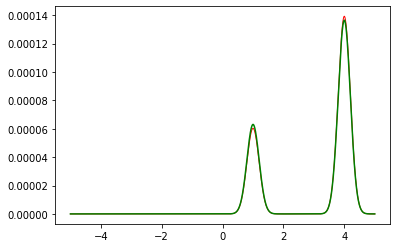

In [13]:
# fig, ax = plt.subplots(figsize=(10, 6))
# x_axis = torch.linspace(-6, 6, 100)

plt.plot(x_axis.detach(), all_normalized_posteriors[-1].detach(), '-r', lw=1, label='GMM posterior')
plt.plot(x_axis.detach(), normalized_true_posterior.detach(), '-g', label='True posterior')
plt.show()


In [14]:
def init_wrapper(approximate_posterior_plt):
    def init():
        approximate_posterior_plt.set_data([], [])
        # approximate_posterior_plt.set_offsets([])
        return (approximate_posterior_plt,)
    return init

def animate_wrapper(approximate_posterior_plt, x_axis, all_normalized_posteriors):
    def animate(i):
        approximate_posterior_plt.set_data(x_axis, all_normalized_posteriors[i])
        return (approximate_posterior_plt,)
    return animate

In [20]:
fig, ax = plt.subplots(figsize=(10, 6))

approximate_posterior_plt, = ax.plot([], [], lw=2, label='GMM posterior')
ax.plot(x_axis.detach(), normalized_true_posterior.detach(), lw=1, label='True posterior')
ani = animate_wrapper(approximate_posterior_plt, x_axis, all_normalized_posteriors)
init = init_wrapper(approximate_posterior_plt)
anim = animation.FuncAnimation(fig, ani, init_func=init,
                               frames=len(all_normalized_posteriors), interval=20,
                               blit=False)
rc('animation', html='jshtml')

In [17]:
anim

In [ ]:
anim.save("./anim_gmm.mp4", dpi=300)